In [ ]:
!pip install -U numpy pillow rembg

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.1/62.1 kB 941.2 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.1/44.1 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.7/54.7 kB 4.2 MB/s eta 0:00:00


# Task
Perform three tests in Google Colab using the `rembg` library to remove the background from an image: Test 1: Remove the background and display the result. Test 2: Remove the background and add a white background. Test 3: Remove the background and add a custom background image. Provide the necessary Python code for each test, including image uploads.

## Upload images

### Subtask:
Provide code to upload the images needed for the tests (the input image for background removal and the custom background image for test-3).


**Reasoning**:
Import the necessary module and use `files.upload()` to prompt the user for image uploads for both the input image and the custom background image.



In [ ]:
from google.colab import files

uploaded_input = files.upload()
uploaded_background = files.upload()

for fn in uploaded_input.keys():
  print(f'Input file "{fn}" uploaded.')

for fn in uploaded_background.keys():
  print(f'Background file "{fn}" uploaded.')

Saving image.jpg to image.jpg


Input file "image.jpg" uploaded.


**Reasoning**:
The user was only prompted to upload the input image. I need to prompt the user to upload the background image as well.



In [ ]:
uploaded_background = files.upload()

for fn in uploaded_background.keys():
  print(f'Background file "{fn}" uploaded.')

Saving Image (1).jpg to Image (1).jpg
Background file "Image (1).jpg" uploaded.


## Test 1: remove background

### Subtask:
Implement the code to remove the background from the uploaded image using `rembg` and display the output.


**Reasoning**:
Implement the code to remove the background from the uploaded image using `rembg` and display the output, following the instructions.



In [ ]:
from PIL import Image
import rembg

input_image_data = list(uploaded_input.values())[0]
output_image_data = rembg.remove(input_image_data)

output_image = Image.open(io.BytesIO(output_image_data))
display(output_image)

ModuleNotFoundError: No module named 'onnxruntime'

**Reasoning**:
The previous command failed because of a missing dependency 'onnxruntime'. Install 'onnxruntime' to fix the issue.



In [ ]:
!pip install onnxruntime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.5/16.5 MB 75.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 7.6 MB/s eta 0:00:00


**Reasoning**:
Now that the necessary dependency is installed, retry the code to remove the background from the uploaded image and display the output.



100%|████████████████████████████████████████| 176M/176M [00:00<00:00, 181GB/s]


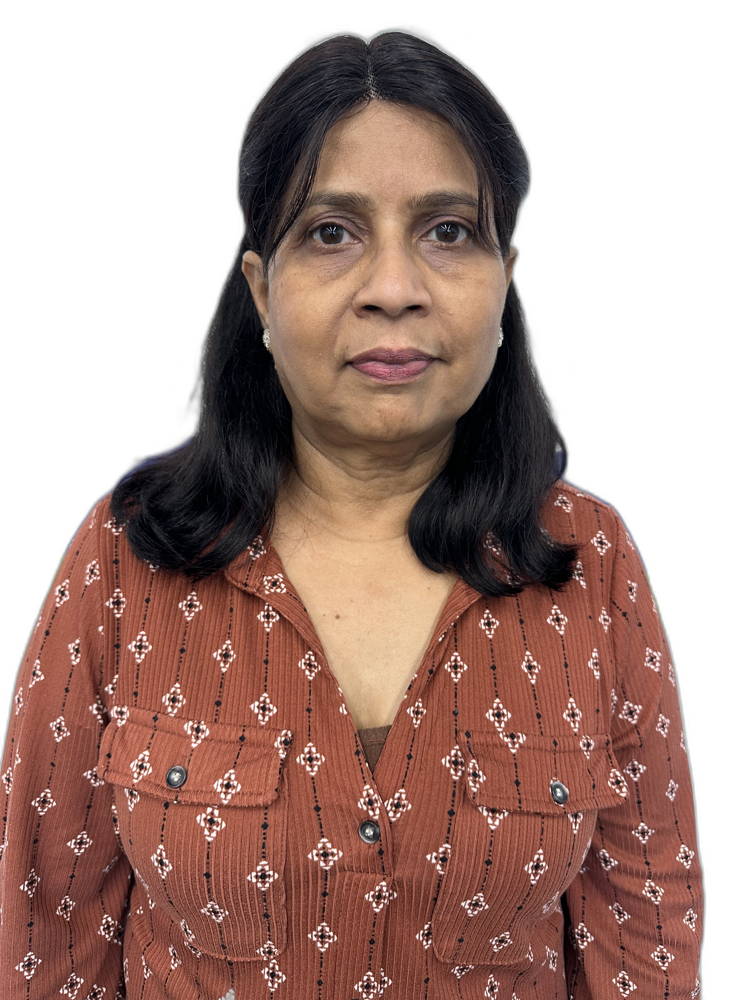

In [ ]:
import io

from PIL import Image
import rembg

input_image_data = list(uploaded_input.values())[0]
output_image_data = rembg.remove(input_image_data)

output_image = Image.open(io.BytesIO(output_image_data))
display(output_image)

## Test 2: Remove background and add white background

### Subtask:
Modify the code to remove the background and replace it with a white background, then display the result.

**Reasoning**:
Use `rembg.remove` as before, but this time specify `bgcolor=(255, 255, 255, 255)` to set the background color to white (RGBA format).

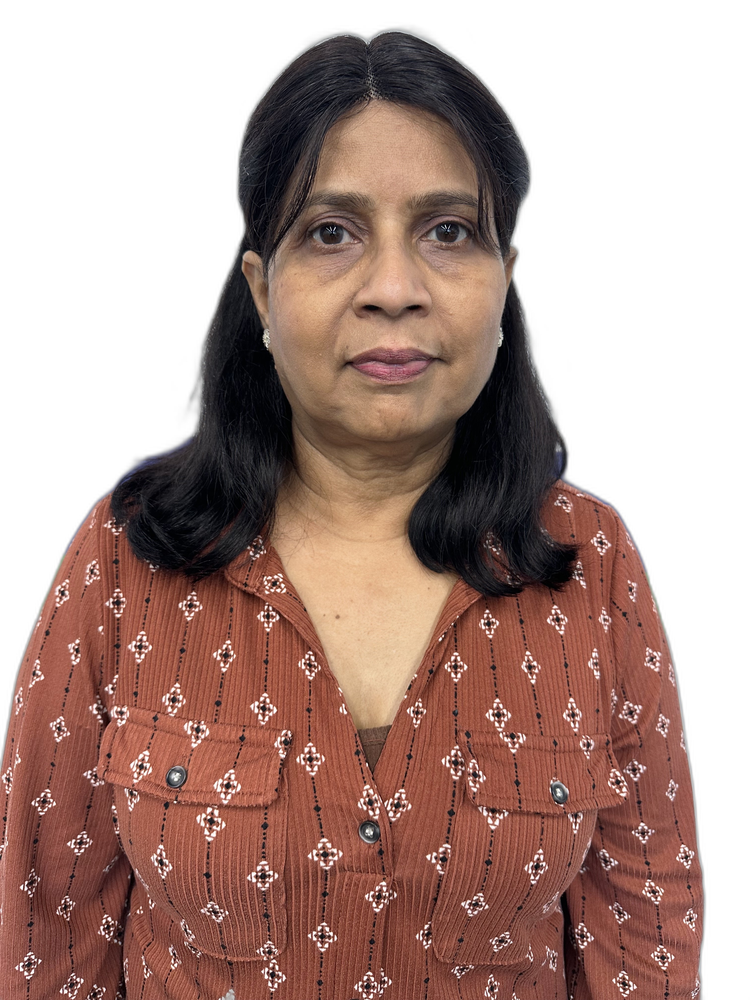

In [ ]:
from PIL import Image
import rembg
import io

input_image_data = list(uploaded_input.values())[0]

# Remove background and add white background
output_image_data_white_bg = rembg.remove(input_image_data, bgcolor=(255, 255, 255, 255))

# Open and display the resulting image
output_image_white_bg = Image.open(io.BytesIO(output_image_data_white_bg))
display(output_image_white_bg)

## Test 3: Remove background and add custom background

### Subtask:
Implement the code to remove the background and overlay the resulting image onto the custom background image, then display the final image.

**Reasoning**:
First, remove the background from the input image. Then, open the custom background image and resize the foreground image (the one with the background removed) to match the size of the background image. Finally, paste the foreground image onto the background image using the alpha channel as a mask for transparency.

In [ ]:
from PIL import Image
import rembg
import io

input_image_data = list(uploaded_input.values())[0]
background_image_data = list(uploaded_background.values())[0]

# Remove background from the input image
output_image_no_bg_data = rembg.remove(input_image_data, alpha_matting=True)
output_image_no_bg = Image.open(io.BytesIO(output_image_no_bg_data)).convert("RGBA")

# Open the custom background image
background_image = Image.open(io.BytesIO(background_image_data)).convert("RGBA")

# Resize the foreground image to match the background image size
foreground_image_resized = output_image_no_bg.resize(background_image.size, Image.Resampling.LANCZOS)

# Paste the foreground image onto the background using the alpha channel as mask
background_image.paste(foreground_image_resized, (0, 0), foreground_image_resized)

# Display the final image
display(background_image)